# About the project - Business Understanding

<h1 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center> TELCO CHURN PREDICTION</center></h1> 

Customer attrition poses a significant financial challenge for businesses in Senegal, representing the rate at which customers discontinue their usage of a company's products or services within a defined time period. Often referred to as customer churn or turnover, this metric measures the percentage of customers lost over a specific duration.

Consider a scenario where a business starts the year with 5000 customers in Senegal but concludes with only 4800 customers; the resulting customer churn rate would be 4%. Identifying the reasons behind customer departures and predicting when these exits are likely to occur can provide invaluable insights for organizations in the Senegalese market. Such insights empower companies to enhance their retention strategies and, consequently, mitigate the impact of customer attrition.

This project is designed to assess the probability of a customer leaving an organization in Senegal, identify key indicators of churn, and propose effective retention strategies. By leveraging data analysis and predictive modeling specific to the Senegalese telecom market, we aim to equip the organization with actionable insights that can inform targeted initiatives to retain customers, ultimately contributing to enhanced customer satisfaction and sustained business growth.  

# data understanding 

user_id:
Unique identifier for each customer.

REGION:
Geographical location of each client.

TENURE:
Duration of the customer's association with the company, categorized by months.

MONTANT:
Amount spent by the customer.

FREQUENCE_RECH:
Frequency of customer recharges.

REVENUE:
Revenue generated from the customer.

ARPU_SEGMENT:
Average Revenue Per User (ARPU) in a specific segment.

FREQUENCE:
Overall frequency of communication activities.

DATA_VOLUME:
Volume of data used by the customer.

ON_NET:
Usage metrics for on-network communication.

ORANGE:
Usage metrics for the Orange network.

TIGO:
Usage metrics for the Tigo network.

ZONE1, ZONE2:
User activity indicators in specific geographical zones.

MRG:
Indicates whether the user is in the process of leaving or has already left (interpreted as "a client who is going").

REGULARITY:
Information on the regularity of user activities.

TOP_PACK:
Specifies the most frequently used service package.

FREQ_TOP_PACK:
Frequency of the most popular service package.

CHURN:
Target variable indicating whether a customer has churned (1) or not (0).

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>Research Questions for Classification Modeling</center></h3> 


General Understanding:

What is the overall churn rate in the dataset?

User Behavior:

Is there a correlation between the duration of customer tenure and churn?
Are there patterns in the frequency of recharges that may serve as predictors for churn?

Monetary Metrics:

How does the amount spent (MONTANT) relate to customer churn?

Service Usage:

Does the usage of specific network providers (ON_NET, ORANGE, TIGO) significantly influence churn?
Are there specific service packages (TOP_PACK) that correlate with higher or lower churn?

Retention Strategies:

What are the key indicators of churn that could be addressed in retention strategies?

Data Volume and Communication:

Does the volume of data used by the customer (DATA_VOLUME) impact churn?
How does the overall frequency of communication activities (FREQUENCE) relate to churn?

Effect of Network Preferences:

Are there preferences for specific network providers that align with lower churn rates?

Predictive Modeling:

Can we build a predictive model to forecast customer churn based on the provided features?
NOTE WELL:

These questions are tailored to highlight aspects that are both relevant for understanding churn patterns and suitable for predictive modeling

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center> SETUP AND INSTALLATIONS</center></h3> 

# Installing Packges 

In [ ]:
# data manipulation 
%pip install pandas
%pip install numpy

# data visualization
%pip install matplotlib
%pip install seaborn

#text cleaning
%pip install nltk

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center> IMPORTING NECESSARY MODULES AND LIBRARIES</center></h3> 

In [3]:
#Import some libraries
import pandas as pd
import numpy as np

# data manipulation 
import matplotlib.pyplot as plt
from pylab import rcParams
import seaborn as sns
sns.set_style('darkgrid')
rcParams['figure.figsize'] = 8,8
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

# text cleaning
import re
import string
from nltk.tokenize import word_tokenize

# Set the display options to show maximum rows and columns

In [4]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center> LOADING THE DATASETS</center></h3> 

In [5]:
# Load datasets

# File paths
train_path = 'data/Train.csv'
test_path = 'data/Test.csv'
SampleSubmission_path = 'data/SampleSubmission.csv'

# datasets
df_train = pd.read_csv(train_path)
df_test = pd.read_csv(test_path)
df_submission = pd.read_csv(SampleSubmission_path)

In [6]:
df_train.head() # checking the head of the train dataset 

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
0,7ee9e11e342e27c70455960acc80d3f91c1286d1,DAKAR,K > 24 month,20000.0,47.0,21602.0,7201.0,52.0,8835.0,3391.0,396.0,185.0,NaN,NaN,NO,62,On net 200F=Unlimited _call24H,30.0,0
1,50443f42bdc92b10388fc56e520e4421a5fa655c,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,3,NaN,NaN,0
2,da90b5c1a9b204c186079f89969aa01cb03c91b2,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,1,NaN,NaN,0
3,364ec1b424cdc64c25441a444a16930289a0051e,SAINT-LOUIS,K > 24 month,7900.0,19.0,7896.0,2632.0,25.0,9385.0,27.0,46.0,20.0,NaN,2.0,NO,61,"Data:490F=1GB,7d",7.0,0
4,d5a5247005bc6d41d3d99f4ef312ebb5f640f2cb,DAKAR,K > 24 month,12350.0,21.0,12351.0,4117.0,29.0,9360.0,66.0,102.0,34.0,NaN,NaN,NO,56,All-net 500F=2000F;5d,11.0,0


<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>GETTING SOME STATISTICAL INFORMATION</center></h3> 

In [7]:
df_train.tail() # checking the train data set 

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
1077019,56e22fe3312a48cf860b043a021dab275383a20a,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,16,NaN,NaN,0
1077020,587b72930e4d36b3fb94a18c3ef65c2079460eee,TAMBACOUNDA,K > 24 month,2500.0,5.0,2500.0,833.0,5.0,0.0,15.0,77.0,NaN,NaN,NaN,NO,34,All-net 500F=2000F;5d,2.0,0
1077021,d6831b8edacb7d9928b3f053fb1283574577ae42,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,3,NaN,NaN,1
1077022,cb1f6510b084173c0deae49095f35ac29f916701,NaN,K > 24 month,600.0,1.0,600.0,200.0,1.0,591.0,11.0,37.0,5.0,1.0,NaN,NO,16,All-net 600F= 3000F ;5d,1.0,0
1077023,28f56fd0d9f8d8647bb6c62e7a3f4f35f49f4d6f,FATICK,K > 24 month,1500.0,4.0,1499.0,500.0,5.0,1265.0,30.0,4.0,NaN,NaN,0.0,NO,50,On net 200F=Unlimited _call24H,2.0,0


In [8]:
df_train.shape # checking the shape of the train data set 

(1077024, 19)

In [9]:
#view the data types in the train data
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1077024 entries, 0 to 1077023
Data columns (total 19 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   user_id         1077024 non-null  object 
 1   REGION          652687 non-null   object 
 2   TENURE          1077024 non-null  object 
 3   MONTANT         699139 non-null   float64
 4   FREQUENCE_RECH  699139 non-null   float64
 5   REVENUE         714669 non-null   float64
 6   ARPU_SEGMENT    714669 non-null   float64
 7   FREQUENCE       714669 non-null   float64
 8   DATA_VOLUME     547261 non-null   float64
 9   ON_NET          683850 non-null   float64
 10  ORANGE          629880 non-null   float64
 11  TIGO            432250 non-null   float64
 12  ZONE1           84898 non-null    float64
 13  ZONE2           68794 non-null    float64
 14  MRG             1077024 non-null  object 
 15  REGULARITY      1077024 non-null  int64  
 16  TOP_PACK        626129 non-null   ob

In [10]:
df_test.head() # checking the head of the test dataset 

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK
0,51fe4c3347db1f8571d18ac03f716c41acee30a4,MATAM,I 18-21 month,2500.0,5.0,2500.0,833.0,5.0,0.0,64.0,70.0,NaN,NaN,NaN,NO,35,All-net 500F=2000F;5d,5.0
1,5ad5d67c175bce107cc97b98c4e37dcc38aa7f3e,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,2,NaN,NaN
2,5a4db591c953a8d8f373877fad37aaf4268899a1,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NO,22,NaN,NaN
3,8bf9b4d8880aeba1c9a0da48be78f12e629be37c,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,6,NaN,NaN
4,c7cdf2af01e9fa95bf498b68c122aa4b9a8d10df,SAINT-LOUIS,K > 24 month,5100.0,7.0,5637.0,1879.0,15.0,7783.0,30.0,24.0,0.0,0.0,NaN,NO,60,"Data:1000F=2GB,30d",4.0


In [11]:
df_test.tail() # checking the tail of the test dataset 

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK
190058,1092956a3dad77ceb7e8d7c70e3e13f77b60e2aa,DAKAR,F 9-12 month,500.0,1.0,506.0,169.0,1.0,0.0,26.0,NaN,NaN,6.0,NaN,NO,14,All-net 500F=2000F;5d,1.0
190059,bec10becca7faa8e9cab9981b3aee5e9a7f04828,DAKAR,K > 24 month,2000.0,4.0,2000.0,667.0,5.0,0.0,8.0,54.0,NaN,NaN,NaN,NO,29,All-net 500F =2000F_AllNet_Unlimited,3.0
190060,7ac6fc191f8732b1b146e57f9ede983626b93eae,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,2,NaN,NaN
190061,d592c81971d6120b0d19f9ace85f278ea21b89a0,NaN,K > 24 month,300.0,2.0,298.0,99.0,2.0,0.0,1.0,2.0,NaN,NaN,NaN,NO,12,NaN,NaN
190062,9b4f57aeef72cd52c634498d0ea27ea3fbb67bf4,NaN,K > 24 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,2,NaN,NaN


In [12]:
df_test.shape # checking the shape of test dataset 

(190063, 18)

In [13]:
df_test.info() # getting some info on the test dataset 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 190063 entries, 0 to 190062
Data columns (total 18 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         190063 non-null  object 
 1   REGION          115330 non-null  object 
 2   TENURE          190063 non-null  object 
 3   MONTANT         123695 non-null  float64
 4   FREQUENCE_RECH  123695 non-null  float64
 5   REVENUE         126422 non-null  float64
 6   ARPU_SEGMENT    126422 non-null  float64
 7   FREQUENCE       126422 non-null  float64
 8   DATA_VOLUME     96716 non-null   float64
 9   ON_NET          120771 non-null  float64
 10  ORANGE          111417 non-null  float64
 11  TIGO            76555 non-null   float64
 12  ZONE1           14850 non-null   float64
 13  ZONE2           12011 non-null   float64
 14  MRG             190063 non-null  object 
 15  REGULARITY      190063 non-null  int64  
 16  TOP_PACK        110773 non-null  object 
 17  FREQ_TOP_P

In [14]:
df_submission.head() # checking the head of the submission dataset 

,user_id,CHURN
0,51fe4c3347db1f8571d18ac03f716c41acee30a4,0
1,5ad5d67c175bce107cc97b98c4e37dcc38aa7f3e,0
2,5a4db591c953a8d8f373877fad37aaf4268899a1,0
3,8bf9b4d8880aeba1c9a0da48be78f12e629be37c,0
4,c7cdf2af01e9fa95bf498b68c122aa4b9a8d10df,0


In [15]:
df_submission.shape # checking the shape of the submission dataset 

(190063, 2)

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>ENSURING THE DATASETS ARE CLEAN</center></h3> 

## 1. TRAIN SET


In [16]:
#Check for missing values in training data
df_train.isnull().sum()

user_id                 0
REGION             424337
TENURE                  0
MONTANT            377885
FREQUENCE_RECH     377885
REVENUE            362355
ARPU_SEGMENT       362355
FREQUENCE          362355
DATA_VOLUME        529763
ON_NET             393174
ORANGE             447144
TIGO               644774
ZONE1              992126
ZONE2             1008230
MRG                     0
REGULARITY              0
TOP_PACK           450895
FREQ_TOP_PACK      450895
CHURN                   0
dtype: int64

# let's get some statistics before before deciding on what to do with imputation or to drop them 

1. we find the percentage of missing values of for each column

In [17]:
# Calculating the percentage of missing values for each column

train_missing_percentage = (df_train.isnull().sum() / len(df_train)) * 100 

# creating a DataFrame to display the results
train_missing_stats = pd.DataFrame({
    'train_columns':df_train.columns,
    'Missing Percentage': train_missing_percentage 
})

# Below we display the results
print(train_missing_stats)

                 train_columns  Missing Percentage
user_id                user_id            0.000000
REGION                  REGION           39.399029
TENURE                  TENURE            0.000000
MONTANT                MONTANT           35.086033
FREQUENCE_RECH  FREQUENCE_RECH           35.086033
REVENUE                REVENUE           33.644097
ARPU_SEGMENT      ARPU_SEGMENT           33.644097
FREQUENCE            FREQUENCE           33.644097
DATA_VOLUME        DATA_VOLUME           49.187669
ON_NET                  ON_NET           36.505593
ORANGE                  ORANGE           41.516624
TIGO                      TIGO           59.866261
ZONE1                    ZONE1           92.117353
ZONE2                    ZONE2           93.612584
MRG                        MRG            0.000000
REGULARITY          REGULARITY            0.000000
TOP_PACK              TOP_PACK           41.864898
FREQ_TOP_PACK    FREQ_TOP_PACK           41.864898
CHURN                    CHURN 

# let's comfirm for outliers to ingnore using mean imoutation 

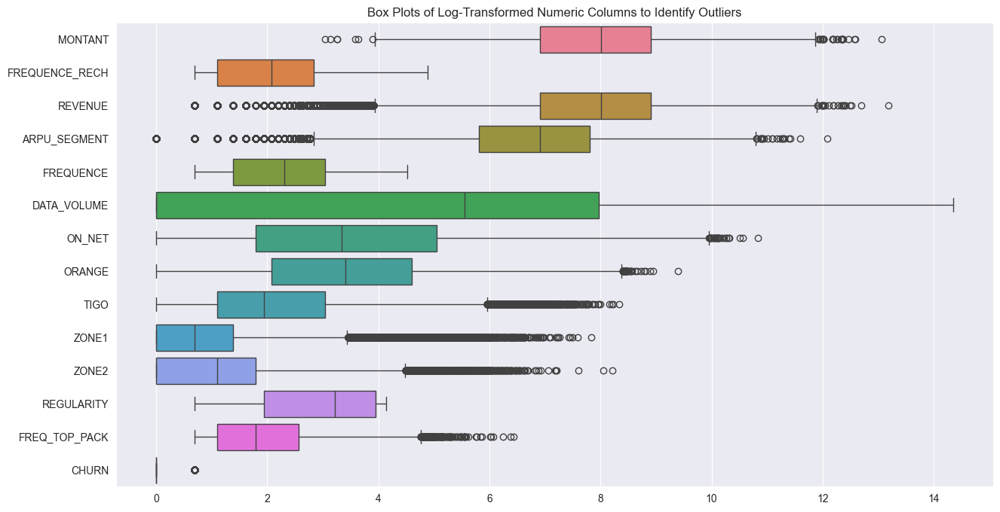

In [18]:
# Selecting columns with numeric values for log transformation
df_train_numerical_col = df_train.select_dtypes(include=['float64', 'int64']).columns

# Below we apply log transformation to numeric columns (adding a small constant to avoid log(0))
df_train_log_transformed = df_train[df_train_numerical_col].apply(lambda x: np.log1p(x))

# below we create a box plots for each log-transformed numeric column
plt.figure(figsize=(15, 8))
sns.boxplot(data=df_train_log_transformed, orient='h')
plt.title("Box Plots of Log-Transformed Numeric Columns to Identify Outliers")
plt.show()

# Box Plot Analysis of Numeric Columns in the df_train Dataset

The box plots provide insights into the distribution of numeric columns in the df_train dataset. Upon log transformation, the analysis reveals the following observations:

1. **Columns with Significant Outliers:** which is mean is not adviceable to impute uning mean
   - MONTANT
   - REVENUE
   - ARPU_SEGMENT
   - ON_NET
   - ORANGE
   - TIGO
   - ZONE1
   - ZONE2
   - FREQ_TOP_PACK

2. **Columns with No Significant Outliers:** These columns with no significant outliers can be mean imputed 
   - FREQUENCE_RECH
   - FREQUENCE
   - DATA_VOLUME
   - REGULARITY
   - FREQ_TOP_PACK

# NOW LET'S IMPUTE THE COLUMNS WITH NO SIGNIFICANT OUTLIERS USING MEAN IMPUTATION

In [19]:
# Below are List of columns to be imputed with mean
columns_to_impute = ['FREQUENCE_RECH', 'FREQUENCE', 'DATA_VOLUME', 'REGULARITY', 'FREQ_TOP_PACK']

# Imputing missing values with mean for selected columns
for column in columns_to_impute:
    mean_value = df_train[column].mean()
    df_train[column].fillna(mean_value, inplace=True)

# Below we verify if there are still any missing values after imputation
missing_values_after_imputation = df_train[columns_to_impute].isnull().sum()

# Below we display the results
print("Missing Values After Mean Imputation:")
print(missing_values_after_imputation)

Missing Values After Mean Imputation:
FREQUENCE_RECH    0
FREQUENCE         0
DATA_VOLUME       0
REGULARITY        0
FREQ_TOP_PACK     0
dtype: int64


# now let's work on the columns with  Significant Outliers 
   - MONTANT
   - REVENUE
   - ARPU_SEGMENT
   - ON_NET
   - ORANGE
   - TIGO
   - ZONE1
   - ZONE2
   - FREQ_TOP_PACK

# now let's impute the columns with significant outliers using median imputation since since the methode is 
# very good when dealing with outliers 

In [20]:
# List of columns for median imputation
columns_to_impute_median = ['MONTANT', 'REVENUE', 'ARPU_SEGMENT', 'ON_NET', 'ORANGE', 'TIGO', 'ZONE1', 'ZONE2', 'FREQ_TOP_PACK']

# Iterate through each column and impute missing values with the median
for column in columns_to_impute_median:
    non_null_filter = ~df_train[column].isnull()
    median_value = df_train[non_null_filter][column].median()
    df_train[column] = df_train[column].fillna(median_value)

#Belw we verify if there are still any missing values after imputation
missing_values_after_imputation = df_train[columns_to_impute_median].isnull().sum()

#below we display the result
print("Missing Values After Median Imputation:")
print(missing_values_after_imputation)

Missing Values After Median Imputation:
MONTANT          0
REVENUE          0
ARPU_SEGMENT     0
ON_NET           0
ORANGE           0
TIGO             0
ZONE1            0
ZONE2            0
FREQ_TOP_PACK    0
dtype: int64


# now let's confirm the df_train data set for null values

In [21]:
df_train.isnull().sum()

user_id                0
REGION            424337
TENURE                 0
MONTANT                0
FREQUENCE_RECH         0
REVENUE                0
ARPU_SEGMENT           0
FREQUENCE              0
DATA_VOLUME            0
ON_NET                 0
ORANGE                 0
TIGO                   0
ZONE1                  0
ZONE2                  0
MRG                    0
REGULARITY             0
TOP_PACK          450895
FREQ_TOP_PACK          0
CHURN                  0
dtype: int64

# let's impute for the categorical columns

# first let's check for the unique values in these columns 

In [22]:
#getting unique values in 'TOP_PACK'
unique_top_pack = df_train['TOP_PACK'].unique()
print("Unique values in 'TOP_PACK':")
print(unique_top_pack)

#getting nique values in 'REGION'
unique_region = df_train['REGION'].unique()
print("\nUnique values in 'REGION':")
print(unique_region)

Unique values in 'TOP_PACK':
['On net 200F=Unlimited _call24H' nan 'Data:490F=1GB,7d'
 'All-net 500F=2000F;5d' 'On-net 500=4000,10d' 'Data:3000F=10GB,30d'
 'Data:200F=Unlimited,24H' 'IVR Echat_Daily_50F' 'Data:1000F=2GB,30d'
 'Mixt 250F=Unlimited_call24H' 'On-net 1000F=10MilF;10d'
 'MIXT:500F= 2500F on net _2500F off net;2d' 'Data: 200 F=100MB,24H'
 'All-net 600F= 3000F ;5d' 'On-net 200F=60mn;1d' 'Twter_U2opia_Daily'
 'Data: 100 F=40MB,24H' 'All-net 500F =2000F_AllNet_Unlimited'
 'On net 200F= 3000F_10Mo ;24H' '200=Unlimited1Day' 'Jokko_Daily'
 'Data:1000F=5GB,7d' 'Data:700F=1.5GB,7d' 'All-net 1000=5000;5d'
 'Data:150F=SPPackage1,24H' 'IVR Echat_Monthly_500F'
 'VAS(IVR_Radio_Daily)' 'MIXT: 390F=04HOn-net_400SMS_400 Mo;4h\t'
 'MIXT: 200mnoff net _unl on net _5Go;30d' 'On-net 500F_FNF;3d'
 'MIXT: 590F=02H_On-net_200SMS_200 Mo;24h\t\t' 'Data:1500F=3GB,30D'
 'Data:300F=100MB,2d' 'Data:500F=2GB,24H' 'Data: 490F=Night,00H-08H'
 'All-net 1000F=(3000F On+3000F Off);5d' 'New_YAKALMA_4_ALL'
 'MI

# now lets get the top five unique values in each column

In [23]:
#below we get the top five unique values in 'TOP_PACK'
top_five_top_pack = df_train['TOP_PACK'].value_counts().head(5)
print("Top five unique values in 'TOP_PACK':")
print(top_five_top_pack)

#below we get the top five unique values in 'REGION'
top_five_region = df_train['REGION'].value_counts().head(5)
print("\nTop five unique values in 'REGION':")
print(top_five_region)

Top five unique values in 'TOP_PACK':
TOP_PACK
All-net 500F=2000F;5d             158779
On net 200F=Unlimited _call24H     76302
Data:490F=1GB,7d                   57679
Data: 100 F=40MB,24H               42515
Mixt 250F=Unlimited_call24H        33620
Name: count, dtype: int64

Top five unique values in 'REGION':
REGION
DAKAR          256259
THIES           90171
SAINT-LOUIS     59895
LOUGA           49679
KAOLACK         48498
Name: count, dtype: int64


# bewlow we impute the missing values using the percentage of the first top unique values in these columns

In [24]:
#below here we print unique values and counts in 'TOP_PACK'
print("Unique values and counts in 'TOP_PACK' after imputation:")
print(df_train['TOP_PACK'].value_counts())

#below here we  Print unique values and counts in 'REGION'
print("\nUnique values and counts in 'REGION' after imputation:")
print(df_train['REGION'].value_counts())

Unique values and counts in 'TOP_PACK' after imputation:
TOP_PACK
All-net 500F=2000F;5d                                158779
On net 200F=Unlimited _call24H                        76302
Data:490F=1GB,7d                                      57679
Data: 100 F=40MB,24H                                  42515
Mixt 250F=Unlimited_call24H                           33620
MIXT:500F= 2500F on net _2500F off net;2d             32164
Data:1000F=2GB,30d                                    29982
All-net 500F =2000F_AllNet_Unlimited                  23476
Jokko_Daily                                           22548
Data: 200 F=100MB,24H                                 21515
IVR Echat_Daily_50F                                   14316
On-net 500=4000,10d                                   13371
On-net 500F_FNF;3d                                    11089
Data:200F=Unlimited,24H                               10986
MIXT: 200mnoff net _unl on net _5Go;30d                9612
On-net 1000F=10MilF;10d           

In [25]:
#Below we impute missing values in 'TOP_PACK' based on the percentage of the top unique values
df_train['TOP_PACK'] = df_train['TOP_PACK'].fillna(df_train['TOP_PACK'].value_counts(normalize=True).index[0])

# Impute missing values in 'REGION' based on the percentage of the top unique values
df_train['REGION'] = df_train['REGION'].fillna(df_train['REGION'].value_counts(normalize=True).index[0])

#Below we verify if there are still any missing values after imputation
missing_values_after_imputation = df_train[['TOP_PACK', 'REGION']].isnull().sum()

#Below we display the result
print("Missing Values After Imputation:")
print(missing_values_after_imputation)

Missing Values After Imputation:
TOP_PACK    0
REGION      0
dtype: int64


In [26]:
# Below we confirm for the null values in the df_train dataset
df_train.isnull().sum()

user_id           0
REGION            0
TENURE            0
MONTANT           0
FREQUENCE_RECH    0
REVENUE           0
ARPU_SEGMENT      0
FREQUENCE         0
DATA_VOLUME       0
ON_NET            0
ORANGE            0
TIGO              0
ZONE1             0
ZONE2             0
MRG               0
REGULARITY        0
TOP_PACK          0
FREQ_TOP_PACK     0
CHURN             0
dtype: int64

# let's check for duplicate values

In [27]:
# checking for duplicate values
df_train_duplicate = df_train[df_train.duplicated()]

#below we display the duplcated rows if there is any
print("Duplicate Rows:")
print(df_train_duplicate)

Duplicate Rows:
Empty DataFrame
Columns: [user_id, REGION, TENURE, MONTANT, FREQUENCE_RECH, REVENUE, ARPU_SEGMENT, FREQUENCE, DATA_VOLUME, ON_NET, ORANGE, TIGO, ZONE1, ZONE2, MRG, REGULARITY, TOP_PACK, FREQ_TOP_PACK, CHURN]
Index: []


In [28]:
df_train.head()

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
0,7ee9e11e342e27c70455960acc80d3f91c1286d1,DAKAR,K > 24 month,20000.0,47.000000,21602.0,7201.0,52.000000,8835.000000,3391.0,396.0,185.0,1.0,2.0,NO,62,On net 200F=Unlimited _call24H,30.000000,0
1,50443f42bdc92b10388fc56e520e4421a5fa655c,DAKAR,K > 24 month,3000.0,11.523756,3000.0,1000.0,13.974439,3368.801722,27.0,29.0,6.0,1.0,2.0,NO,3,All-net 500F=2000F;5d,9.262446,0
2,da90b5c1a9b204c186079f89969aa01cb03c91b2,DAKAR,K > 24 month,3000.0,11.523756,3000.0,1000.0,13.974439,3368.801722,27.0,29.0,6.0,1.0,2.0,NO,1,All-net 500F=2000F;5d,9.262446,0
3,364ec1b424cdc64c25441a444a16930289a0051e,SAINT-LOUIS,K > 24 month,7900.0,19.000000,7896.0,2632.0,25.000000,9385.000000,27.0,46.0,20.0,1.0,2.0,NO,61,"Data:490F=1GB,7d",7.000000,0
4,d5a5247005bc6d41d3d99f4ef312ebb5f640f2cb,DAKAR,K > 24 month,12350.0,21.000000,12351.0,4117.0,29.000000,9360.000000,66.0,102.0,34.0,1.0,2.0,NO,56,All-net 500F=2000F;5d,11.000000,0


In [29]:
df_uniq_churn = df_train['CHURN'].unique # we want to conafirm the unique values in the churn column
print(df_uniq_churn)

<bound method Series.unique of 0          0
1          0
2          0
3          0
4          0
5          0
6          0
7          0
8          1
9          0
10         0
11         0
12         0
13         0
14         1
15         0
16         0
17         0
18         0
19         0
20         0
21         0
22         0
23         0
24         0
25         0
26         1
27         0
28         0
29         0
30         0
31         1
32         0
33         0
34         0
35         0
36         0
37         0
38         0
39         0
40         0
41         1
42         1
43         0
44         0
45         0
46         1
47         0
48         0
49         0
50         0
51         1
52         0
53         0
54         0
55         0
56         0
57         0
58         0
59         0
60         0
61         0
62         0
63         0
64         0
65         1
66         0
67         0
68         0
69         0
70         0
71         0
72         0
73         0
74     

In [30]:
#below we check unique values in the 'CHURN' column to be sure
unique_values_churn = df_train['CHURN'].value_counts()

#belo we display the unique values
print(unique_values_churn)

CHURN
0    875031
1    201993
Name: count, dtype: int64


# converting 'TOP_PACK and REGION' into lower case and performing other text cleaning 

In [31]:
# performing text cleaning 

df_train[['REGION', 'TOP_PACK', 'MRG']] = df_train[['REGION', 'TOP_PACK', 'MRG']].apply(lambda x: x.str.lower())

#below is a function to remove punctuation
def remove_punc(text):
    return text.translate(str.maketrans('', '', string.punctuation))

# below we apply the function to the TOP_PACK column 
df_train['TOP_PACK'] = df_train['TOP_PACK'].apply(remove_punc)

# below we we carried out correlation analysis to determine which variables are not important 

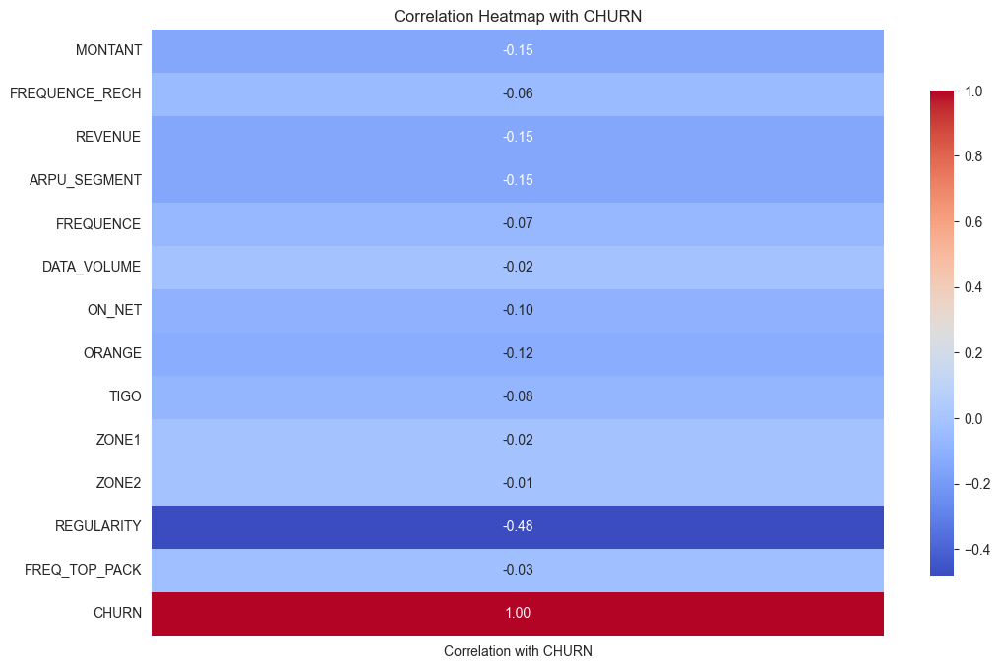

In [32]:
#here we select only numeric columns
numeric_columns = df_train.select_dtypes(include=['float64', 'int64']).columns

#below here we calculate the correlations
correlations = df_train[numeric_columns].corrwith(df_train['CHURN'])

#below we plot the correlation heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlations.to_frame('Correlation with CHURN'), annot=True, cmap='coolwarm', fmt=".2f", cbar_kws={"shrink": 0.8})
plt.title('Correlation Heatmap with CHURN')
plt.show()

MONTANT (Amount Spent): -0.15
Interpretation: There is a negative correlation of -0.15 between the amount spent ('MONTANT') and churn. This suggests that customers who spend less are slightly more likely to churn.

FREQUENCE_RECH (Recharge Frequency): -0.06
Interpretation: There is a weak negative correlation of -0.06 between recharge frequency ('FREQUENCE_RECH') and churn. A lower frequency of customer recharges is weakly associated with a higher likelihood of churn.

REVENUE (Revenue Generated): -0.15
Interpretation: There is a negative correlation of -0.15 between revenue generated ('REVENUE') and churn. Customers generating less revenue are slightly more likely to churn.

ARPU_SEGMENT (Average Revenue Per User): -0.15
Interpretation: There is a negative correlation of -0.15 between average revenue per user in a specific segment ('ARPU_SEGMENT') and churn. Lower ARPU is associated with a higher likelihood of churn.

FREQUENCE (Overall Frequency): -0.07
Interpretation: There is a negative correlation of -0.07 between overall communication frequency ('FREQUENCE') and churn. Customers with lower overall communication frequency are slightly more likely to churn.

DATA_VOLUME (Data Usage Volume): -0.02
Interpretation: There is a weak negative correlation of -0.02 between data usage volume ('DATA_VOLUME') and churn. Lower data usage is weakly associated with a higher likelihood of churn.

ON_NET (On-Network Communication): -0.10
Interpretation: There is a negative correlation of -0.10 between on-network communication metrics ('ON_NET') and churn. Lower on-network usage is associated with a higher likelihood of churn.

ORANGE (Orange Network Usage): -0.12
Interpretation: There is a negative correlation of -0.12 between Orange network usage ('ORANGE') and churn. Lower usage of the Orange network is associated with a higher likelihood of churn.

TIGO (Tigo Network Usage): -0.08
Interpretation: There is a negative correlation of -0.08 between Tigo network usage ('TIGO') and churn. Lower usage of the Tigo network is associated with a higher likelihood of churn.

ZONE1: -0.02
Interpretation: There is a weak negative correlation of -0.02 for user activity in geographical Zone 1 ('ZONE1') and churn. Lower user activity in Zone 1 is weakly associated with a higher likelihood of churn.

ZONE2: -0.01
Interpretation: There is a very weak negative correlation of -0.01 for user activity in geographical Zone 2 ('ZONE2') and churn. User activity in Zone 2 has minimal association with churn.

REGULARITY (User Activity Regularity): -0.48
Interpretation: There is a strong negative correlation of -0.48 between user activity regularity ('REGULARITY') and churn. Customers with less regular activity are strongly associated with a higher likelihood of churn.

FREQ_TOP_PACK (Frequency of Top Service Package): -0.03
Interpretation: There is a weak negative correlation of -0.03 between the frequency of the most popular service package ('FREQ_TOP_PACK') and churn. A lower frequency of the top service package is weakly associated with a higher likelihood of churn.

These interpretations provide a general understanding of how each variable correlates with the target variable 'CHURN.' Keeping in mind that correlation does not imply causation, and other factors may contribute to the observed patterns. Further analysis and domain knowledge are essential for a comprehensive understanding of the whole picture which will be carried out below 

# Based on the correlation test, the domain knowlegde and the variable definitions we consider dropping 
# these columns based on the  following reasons

User ID:

Reason: The User ID serves as a unique identifier for each customer but lacks predictive power for churn. In the context of our objective to forecast customer churn, retaining this column is unnecessary. Therefore, it is recommended to drop the User ID column.

MRG (Merged Accounts):

Reason: The MRG column likely indicates whether users have merged their accounts. However, if this information is not anticipated to be influential in predicting churn, it can be safely dropped from the dataset. Merged account status may not be a significant factor in determining customer churn.

REGION (Geographical Location):

Reason: While geographical location can impact user behavior, it might not strongly correlate with customer churn. As a preliminary step, dropping the REGION column is suggested. The impact on model performance can be assessed later during model evaluation.

ZONE1 and ZONE2 (User Activity in Geographical Zones):

Reason: If ZONE1 and ZONE2 represent user activity in specific geographical zones and are not expected to play a significant role in predicting churn, it is advisable to drop these columns. The geographic distribution of user activity may not be a decisive factor in forecasting customer churn.

TOP_PACK (Most Frequently Used Service Package):

Reason: Depending on the analysis of feature importance, if the 'TOP_PACK' column does not make a substantial contribution to predicting churn, it may be considered for removal. The most frequently used service package might not be a key indicator of customer churn.

FREQ_TOP_PACK (Frequency of the Most Popular Service Package):

Reason: Similar to 'TOP_PACK,' if the frequency of the most popular service package does not strongly correlate with churn, it can be dropped. Assessing its impact on model performance will guide the decision to retain or remove this column

In [33]:
#below we drop specified columns
columns_to_drop = ['user_id', 'MRG', 'REGION', 'ZONE1', 'ZONE2', 'TOP_PACK', 'FREQ_TOP_PACK']
df_train = df_train.drop(columns=columns_to_drop)

let's confirm our changes

In [34]:
df_train.head()

,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,REGULARITY,CHURN
0,K > 24 month,20000.0,47.000000,21602.0,7201.0,52.000000,8835.000000,3391.0,396.0,185.0,62,0
1,K > 24 month,3000.0,11.523756,3000.0,1000.0,13.974439,3368.801722,27.0,29.0,6.0,3,0
2,K > 24 month,3000.0,11.523756,3000.0,1000.0,13.974439,3368.801722,27.0,29.0,6.0,1,0
3,K > 24 month,7900.0,19.000000,7896.0,2632.0,25.000000,9385.000000,27.0,46.0,20.0,61,0
4,K > 24 month,12350.0,21.000000,12351.0,4117.0,29.000000,9360.000000,66.0,102.0,34.0,56,0


<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>EXPLORATORY DATA ANALYSIS</center></h3> 

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>UNIVARIANT ANALYSIS</center></h3> 

# 1. What is the overall churn rate in the dataset?

In [35]:
#below we calculate the overall churn rate 
total_customers = len(df_train)
churned_customers = df_train['CHURN'].sum()
churn_rate = (churned_customers / total_customers) * 100

print(f'Overall Churn Rate: {churn_rate:.2f}%')

Overall Churn Rate: 18.75%



From the above oustput the overall churn rate in the dataset stands at 18.75%, indicating that approximately 18.75% of customers have discontinued their services or become inactive over the specified period. This insight serves as a pivotal baseline for further analysis, allowing us to delve into the factors influencing customer churn and formulate strategies to mitigate it.

# Duration of Customer Tenure and Churn:
The correlation between the duration of customer tenure and churn is an essential aspect to understand. It can provide insights into whether customers who have been associated with the company for a more extended period are less likely to churn.

In [36]:
#below we calculate the correlation between tenure and churn
tenure_churn_corr = df_train['TENURE'].astype('category').cat.codes.corr(df_train['CHURN'])

print(f"Correlation between Duration of Customer Tenure and Churn: {tenure_churn_corr:.2f}")

Correlation between Duration of Customer Tenure and Churn: -0.04


The correlation between the duration of customer tenure and churn is approximately -0.04. This suggests a very weak negative correlation between the two variables. In other words, there is a slight tendency that as the duration of customer tenure increases, the likelihood of churn slightly decreases. However, the correlation is close to zero, indicating that there isn't a strong linear relationship between these variables.

# Monetary Metrics:

How does the amount spent (MONTANT) relate to customer churn?

Since we are primarily interested in exploring the distribution and characteristics of the amount spent by customers and how it relates to churn, a univariate analysis is appropriate. This allows us to gain insights into the MONTANT variable's behavior on its own without considering other variables initially.

# Univariate analysis: Amount spent (MONTANT) and its relation to customer churn

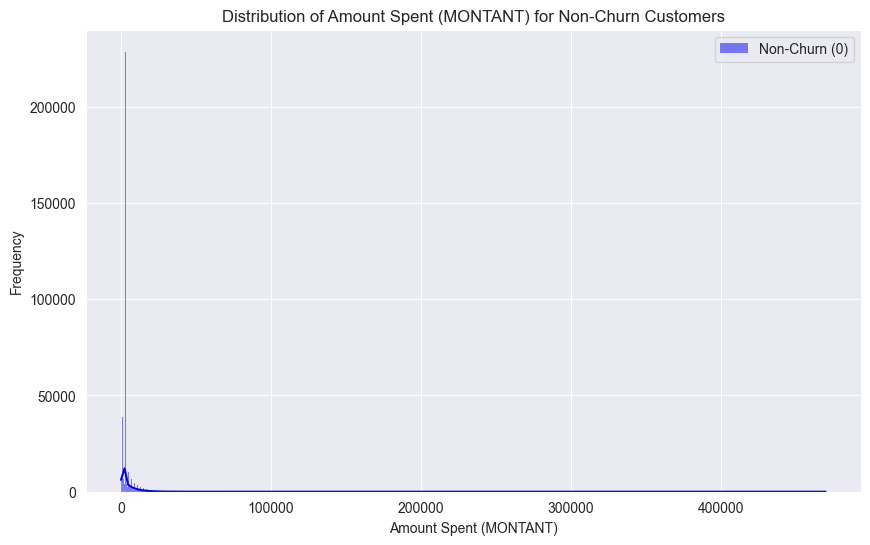

In [37]:
#below we plot a distribution of MONTANT for non-churn customers (CHURN = 0)
plt.figure(figsize=(10, 6))
sns.histplot(df_train[df_train['CHURN'] == 0]['MONTANT'], kde=True, color='blue', label='Non-Churn (0)')
plt.title('Distribution of Amount Spent (MONTANT) for Non-Churn Customers')
plt.xlabel('Amount Spent (MONTANT)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

The left-skewed distribution in the original scale implies that there is a concentration of lower values of the amount spent (MONTANT) for non-churn customers (CHURN = 0). Here's how we interpret the left-skewed distribution:

Concentration of Lower Values:

The majority of non-churn customers tend to spend lower amounts, contributing to the left-skewed appearance.
The left tail is longer, indicating the presence of some customers with very low spending.
Asymmetry towards Lower Values:

The distribution is asymmetric, with more data points towards the lower end of the amount spent.
This suggests that a significant portion of non-churn customers has lower spending habits.
Interquartile Range (IQR):

The bulk of the data (interquartile range) is likely concentrated in the lower values of the amount spent.
Fewer High Spenders:

There are fewer non-churn customers who are high spenders, leading to the elongation of the left tail.
Positive Skewness:

Positive skewness indicates that the right side of the distribution (higher values) is less pronounced compared to the left side.

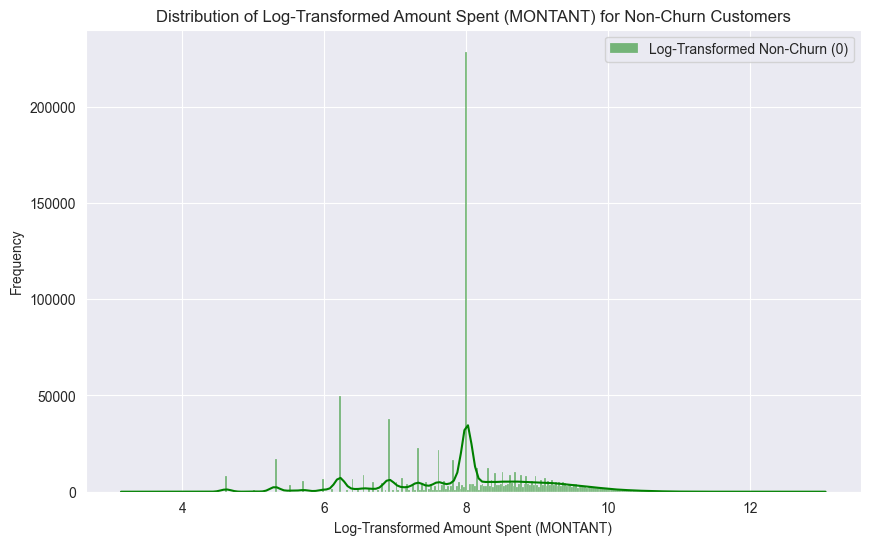

In [38]:
#below we plot a distribution of log-transformed MONTANT for non-churn customers (CHURN = 0)
plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(df_train[df_train['CHURN'] == 0]['MONTANT']), kde=True, color='green', label='Log-Transformed Non-Churn (0)')
plt.title('Distribution of Log-Transformed Amount Spent (MONTANT) for Non-Churn Customers')
plt.xlabel('Log-Transformed Amount Spent (MONTANT)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

<h3 style='background:#0A4D68; border:3; color:cyan; border-color:cyan; border-style:dotted;'><center>BIVARIANT ANALYSIS</center></h3> 

# Frequency of Recharges and Churn:
Analyzing patterns in the frequency of recharges is crucial, as it may serve as a potential predictor for customer churn. Understanding whether customers who recharge more frequently exhibit different churn behavior can aid in the development of targeted retention strategies.

In [39]:
#Below we calculate the correlation between recharge frequency and churn
recharge_freq_churn_corr = df_train['FREQUENCE_RECH'].corr(df_train['CHURN'])
print(f"Correlation between Recharge Frequency and Churn: {recharge_freq_churn_corr:.2f}")

Correlation between Recharge Frequency and Churn: -0.06


The correlation between recharge frequency and churn is approximately -0.06. This indicates a weak negative correlation between the two variables. In other words, there is a slight tendency that as the recharge frequency decreases, the likelihood of churn slightly increases.

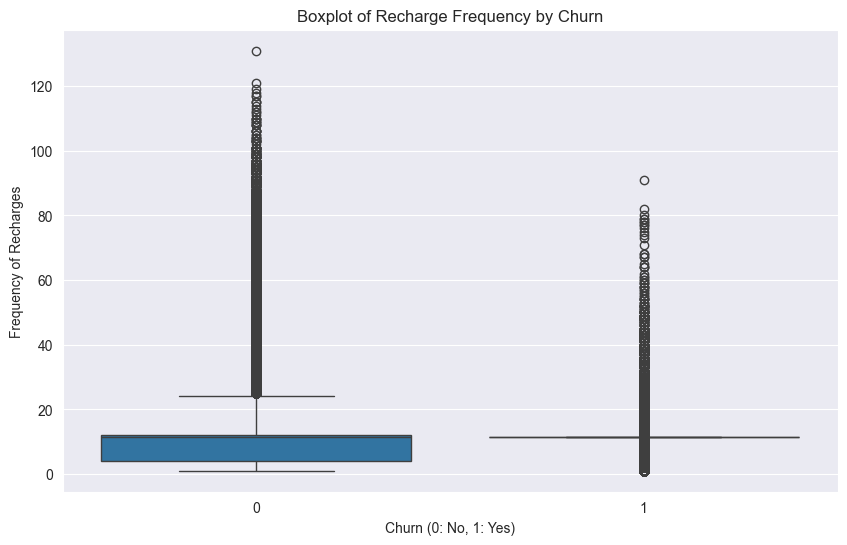

In [41]:
#below we use a boxplot to visualize the Recharge Frequency by Churn
plt.figure(figsize=(10, 6))
sns.boxplot(x='CHURN', y='FREQUENCE_RECH', data=df_train)
plt.title('Boxplot of Recharge Frequency by Churn')
plt.xlabel('Churn (0: No, 1: Yes)')
plt.ylabel('Frequency of Recharges')
plt.show()

Non-Churn (0) Group:

The box itself is closer to the bottom whisker, indicating that the distribution of recharge frequency is more concentrated in the lower range for customers who did not churn.
The median line in the box is close to the upper edge, suggesting that the central tendency of recharge frequency is relatively higher for non-churn customers.
The distribution spans from 0 to 80, with some outliers suggesting occasional higher recharge frequencies.

Churn (1) Group:

There is no box visible, indicating that the distribution of recharge frequency is less concentrated and more dispersed for customers who churned.
The thick horizontal line represents the median, and its position indicates that the central tendency of recharge frequency is relatively lower for churned customers compared to non-churn customers.
The distribution spans from 0 to 40, with some outliers suggesting occasional higher recharge frequencies but generally lower than the non-churn group.
These insights from the boxplot align with the earlier correlation result, showing a weak negative correlation between recharge frequency and churn. The visual representation provides a clearer understanding of the distributional differences between churn and non-churn groups in terms of recharge frequency.

# Data Volume (DATA_VOLUME) Visualization:

# Reason

Visualizing the Data Volume (DATA_VOLUME) in relation to churn can help in understanding how the amount of data used by customers might be associated with their likelihood to churn. Here are some reasons for conducting this visualization:

Identifying Patterns:

Visualization allows us a team to observe patterns and trends in the distribution of data volume for both churned and non-churned customers. It helps identify whether there are distinct patterns or if the data volume is similar across both groups.

Outlier Detection:

Visualization can highlight any outliers in data volume for each group. Outliers might represent extreme values that could be influential in predicting churn.

Comparison Between Groups:

By comparing the distribution of data volume for churned and non-churned customers, we can discern if there's a noticeable difference. This difference may provide insights into whether higher or lower data volume is associated with churn.

Feature Importance:

Understanding the impact of data volume on churn is essential for feature selection in predictive modeling. It helps identify which features contribute significantly to predicting the target variable.

Decision Support for Retention Strategies:

If there's a clear association between data volume and churn, the insights gained from visualization can inform retention strategies. For example, we can then suggest to the company to focus on offering targeted data-related promotions or services to customers with specific usage pattern

# Data_Volume Visualizations

# for non-churn

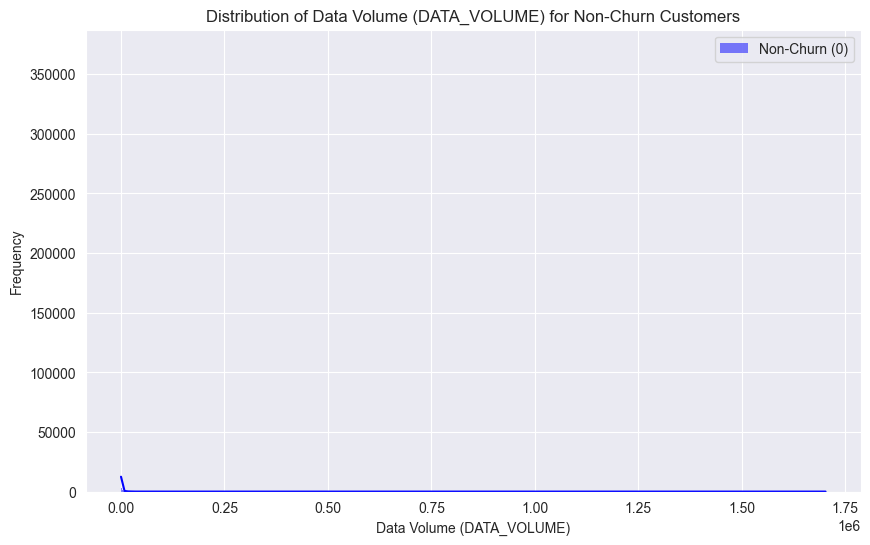

In [43]:
#Below we plot distribution of DATA_VOLUME for non-churn customers (CHURN = 0)
plt.figure(figsize=(10, 6))
sns.histplot(df_train[df_train['CHURN'] == 0]['DATA_VOLUME'], kde=True, color='blue', label='Non-Churn (0)')
plt.title('Distribution of Data Volume (DATA_VOLUME) for Non-Churn Customers')
plt.xlabel('Data Volume (DATA_VOLUME)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# for churn 

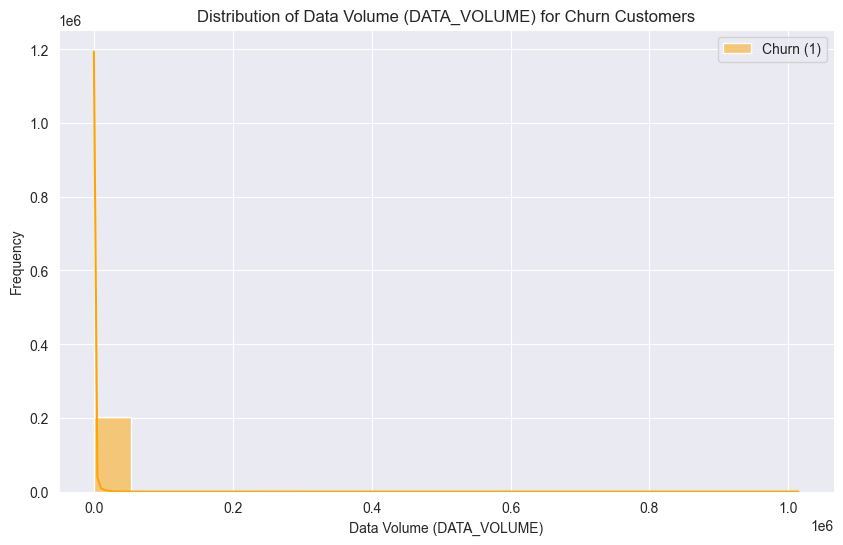

In [44]:
##Below we plot distribution DATA_VOLUME for churn customers (CHURN = 1)
plt.figure(figsize=(10, 6))
sns.histplot(df_train[df_train['CHURN'] == 1]['DATA_VOLUME'], kde=True, color='orange', label='Churn (1)')
plt.title('Distribution of Data Volume (DATA_VOLUME) for Churn Customers')
plt.xlabel('Data Volume (DATA_VOLUME)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# Overall Frequency of Communication (FREQUENCE) Analysis:

# visualizations 

# for non-churn

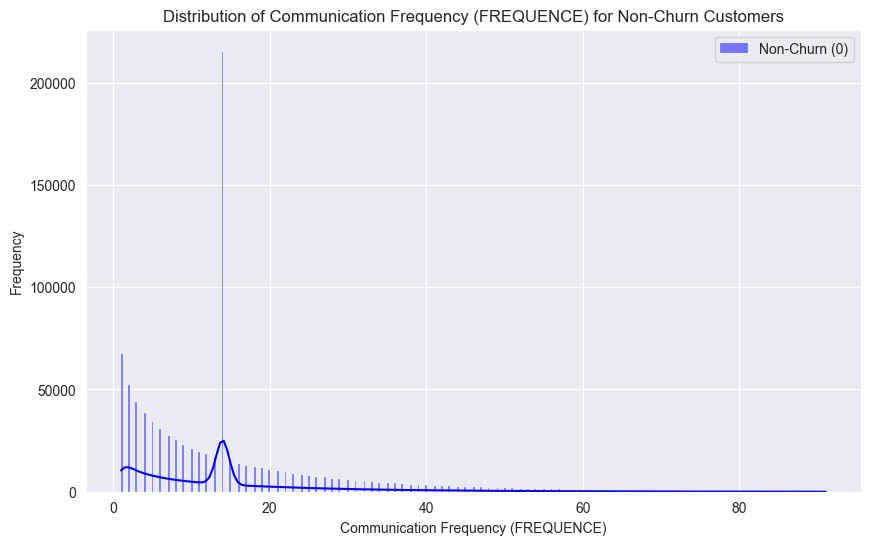

In [45]:
#Below we plot distribution of FREQUENCE for non-churn customers (CHURN = 0)
plt.figure(figsize=(10, 6))
sns.histplot(df_train[df_train['CHURN'] == 0]['FREQUENCE'], kde=True, color='blue', label='Non-Churn (0)')
plt.title('Distribution of Communication Frequency (FREQUENCE) for Non-Churn Customers')
plt.xlabel('Communication Frequency (FREQUENCE)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# for churn 

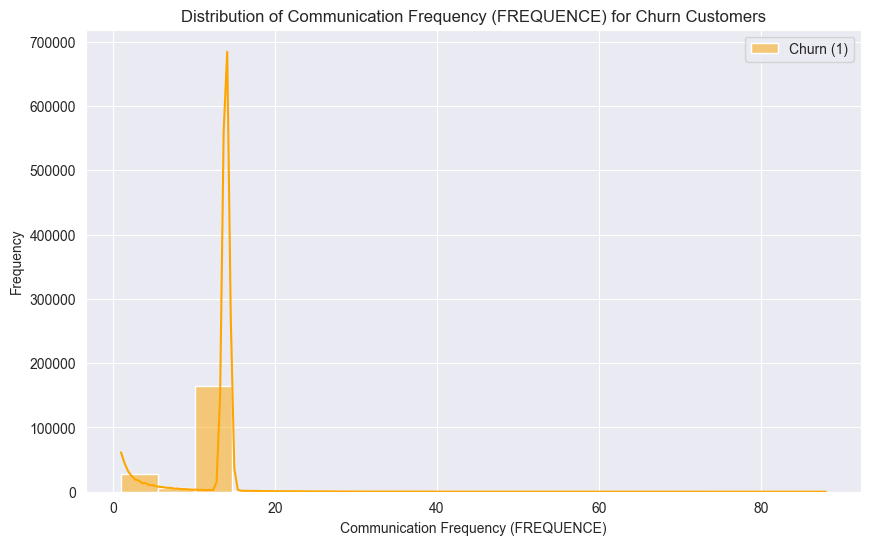

In [46]:
#Below we plot distribution of FREQUENCE for churn customers (CHURN = 1)
plt.figure(figsize=(10, 6))
sns.histplot(df_train[df_train['CHURN'] == 1]['FREQUENCE'], kde=True, color='orange', label='Churn (1)')
plt.title('Distribution of Communication Frequency (FREQUENCE) for Churn Customers')
plt.xlabel('Communication Frequency (FREQUENCE)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# boxplot for churn 

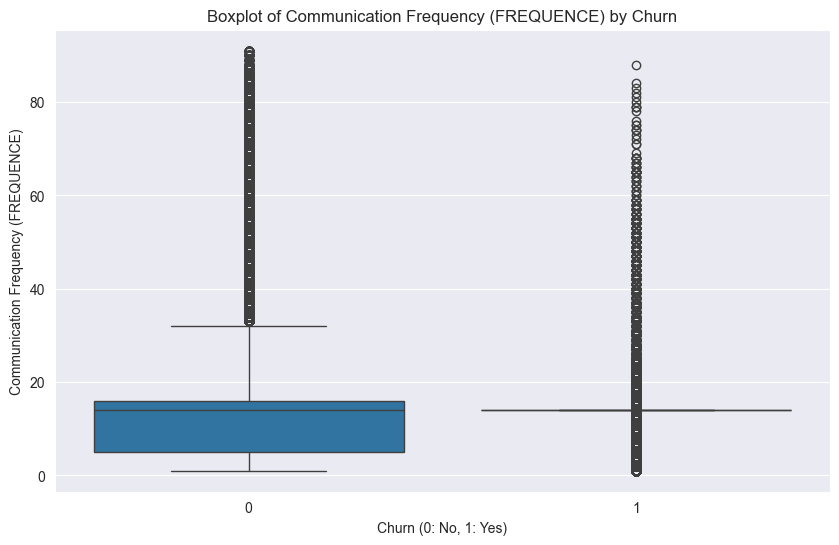

In [47]:
#Below we used a Boxplot to visualize FREQUENCE by Churn
plt.figure(figsize=(10, 6))
sns.boxplot(x='CHURN', y='FREQUENCE', data=df_train)
plt.title('Boxplot of Communication Frequency (FREQUENCE) by Churn')
plt.xlabel('Churn (0: No, 1: Yes)')
plt.ylabel('Communication Frequency (FREQUENCE)')
plt.show()

# Analyzing Network Preferences and Churn

Reason for Analyzing Network Preferences and Churn:

Understanding the relationship between network preferences and churn is crucial for a telecom company. Here are the reasons for conducting this 
analysis:

Service Quality Perception: 

Different network providers may offer varying levels of service quality, coverage, and reliability. Analyzing churn rates associated with each provider helps in understanding if service quality perception plays a role in customer retention.

Competitive Analysis: 

Telecom markets are often competitive, and customer preferences for network providers can impact market share. Analyzing churn rates in relation to network preferences provides insights into how the company's services compare with competitors.

Targeted Marketing: 

If specific network providers are associated with lower churn rates, the company can tailor marketing strategies to promote those providers. This targeted approach can help retain existing customers and attract new ones by emphasizing the benefits of the preferred providers.

Operational Improvements:

Identifying network preferences and their impact on churn may reveal areas for operational improvements. For instance, if a certain provider has higher churn, it could indicate issues with network performance or customer satisfaction that need addressing.

Strategic Decision-Making:

The analysis contributes to strategic decision-making within the company. Insights into network preferences can guide resource allocation, investment decisions, and overall business strategy.

# Visualizations:

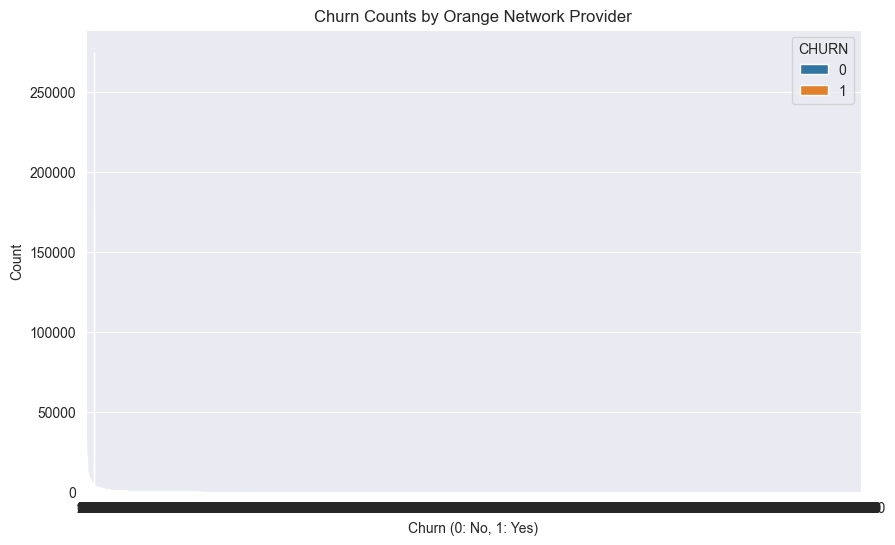

In [48]:
#Below we plot a Bar Chart or Count Plot
plt.figure(figsize=(10, 6))
sns.countplot(x='ORANGE', hue='CHURN', data=df_train)
plt.title('Churn Counts by Orange Network Provider')
plt.xlabel('Churn (0: No, 1: Yes)')
plt.ylabel('Count')
plt.show()

<Figure size 1200x800 with 0 Axes>

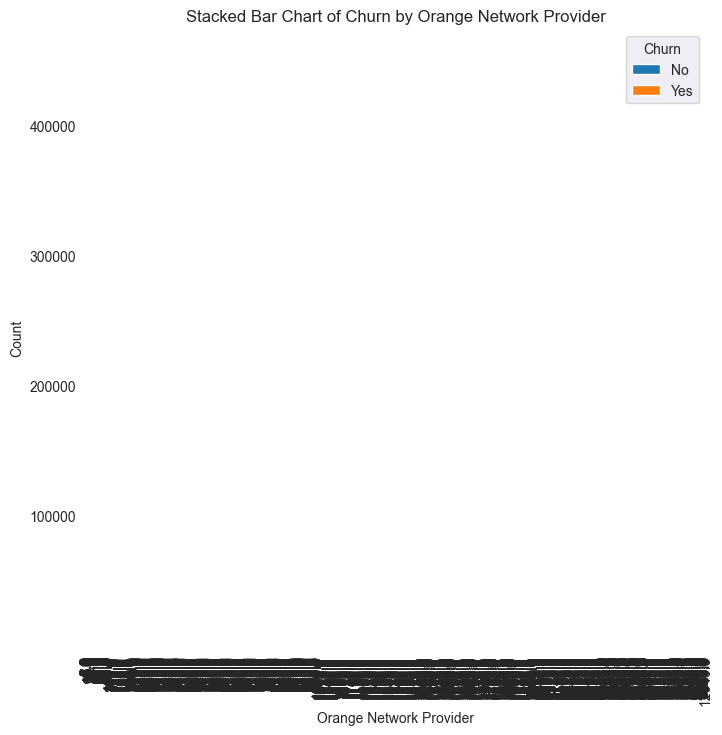

In [49]:
#below we plot a Stacked Bar Chart
plt.figure(figsize=(12, 8))
pd.crosstab(df_train['ORANGE'], df_train['CHURN']).plot(kind='bar', stacked=True)
plt.title('Stacked Bar Chart of Churn by Orange Network Provider')
plt.xlabel('Orange Network Provider')
plt.ylabel('Count')
plt.legend(title='Churn', labels=['No', 'Yes'])
plt.show()

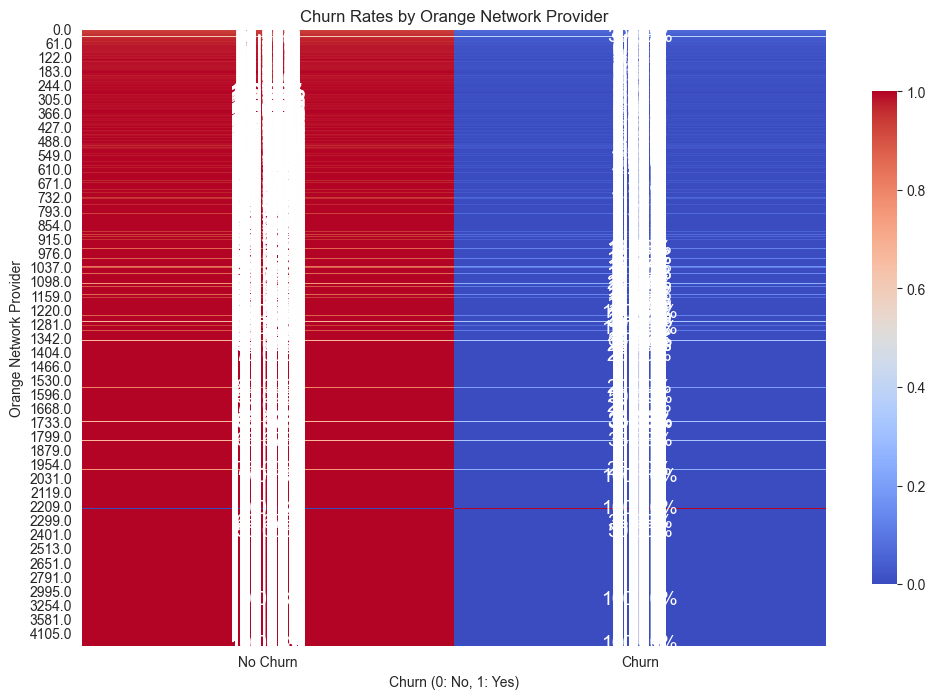

In [56]:
#below we use a Heatmap to show the percentage of churn or no-churn base on network categories 
plt.figure(figsize=(12, 8))
heatmap_data = pd.crosstab(df_train['ORANGE'], df_train['CHURN'], normalize='index')
sns.heatmap(heatmap_data, annot=True, fmt=".2%", cmap='coolwarm', cbar_kws={"shrink": 0.8}, annot_kws={"size": 14, "color": 'white'})
plt.title('Churn Rates by Orange Network Provider')
plt.xlabel('Churn (0: No, 1: Yes)')
plt.ylabel('Orange Network Provider')
plt.xticks(ticks=[0.5, 1.5], labels=['No Churn', 'Churn'], rotation=0)
plt.show()

 Here's a breakdown or  interpretation from the heatmap:

The rows represent different categories or levels of the Orange network provider (e.g., different plans or types).
The columns represent the churn status (0: No Churn, 1: Churn).
The cells in the heatmap are filled with percentages, indicating the proportion of customers in each Orange network category who either churned (1) or did not churn (0). The annotations within each cell provide these percentages.

Darker colors (e.g., dark blue) represent higher percentages, indicating a higher churn rate.
Lighter colors (e.g., light blue) represent lower percentages, indicating a lower churn rate.
The x-axis shows the churn status, and the y-axis shows the categories of the Orange network provider.
This heatmap helps visualize how churn rates vary across different categories of the Orange network provider.

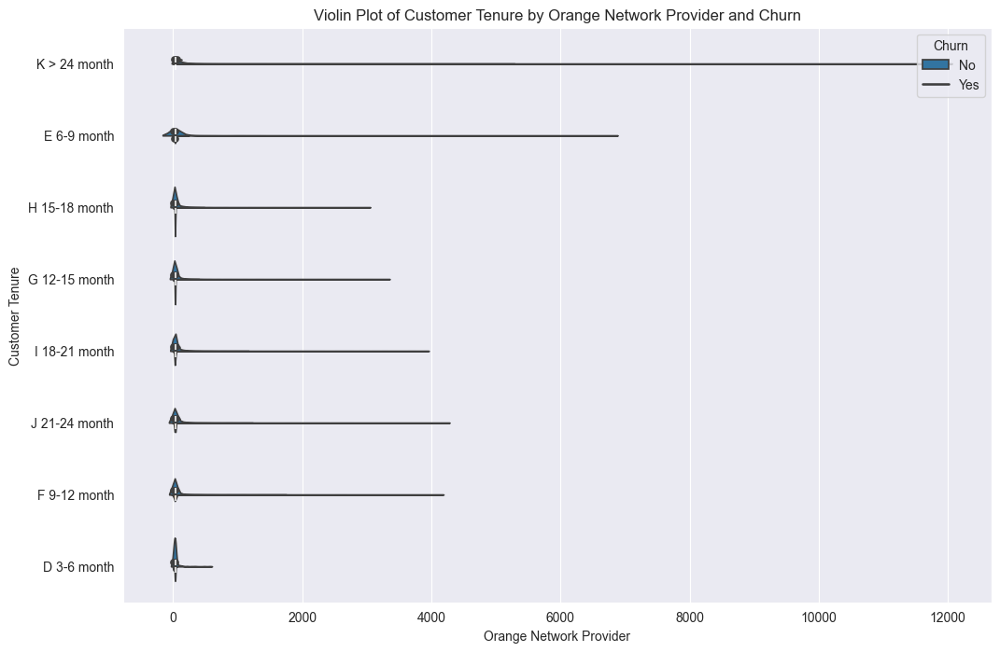

In [51]:
#below we use a  Boxplot or Violin Plot
plt.figure(figsize=(12, 8))
sns.violinplot(x='ORANGE', y='TENURE', hue='CHURN', data=df_train, split=True)
plt.title('Violin Plot of Customer Tenure by Orange Network Provider and Churn')
plt.xlabel('Orange Network Provider')
plt.ylabel('Customer Tenure')
plt.legend(title='Churn', labels=['No', 'Yes'])
plt.show()